# Environment Preparation


In [1]:
import os
os.environ["OPENCV_IO_ENABLE_OPENEXR"]="1"

import time
import random
import tensorflow as tf
import time
import cv2
import numpy as np
import matplotlib.pyplot as plt
import plotly
import plotly.graph_objs as go

metrics=['accuracy', tf.keras.metrics.Precision(), tf.keras.metrics.Recall(), tf.keras.metrics.BinaryIoU()]

In [3]:
from google.colab import drive
drive.mount('/content/gdrive')
root_path = 'gdrive/My Drive/Colab Notebooks/'

MOTION_CAM_MAX_RANGE = 1800
#DATASET_THRUSTER = root_path + '/Skeletex3DData/thruster/'
DATASET_ARMADILLO = root_path + '/Skeletex3DData/armadillo/'
MODELS = root_path + '/Models/'
DATASET = DATASET_ARMADILLO
NOISE_MULT = 2.0

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


# Data Loading


In [4]:
def load_scan(positions_path, normals_path, load_xyz=False):
  positions = cv2.imread(positions_path,  cv2.IMREAD_ANYCOLOR | cv2.IMREAD_ANYDEPTH)
  positions = cv2.resize(positions, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
  normals = cv2.imread(normals_path,  cv2.IMREAD_ANYCOLOR | cv2.IMREAD_ANYDEPTH)
  normals = cv2.resize((normals + 1) / 2, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
  xyz = []
  if (load_xyz):
    for y in range(positions.shape[0]):
      for x in range(positions.shape[1]):
        if random.randrange(20) == 0 and not (np.all(positions[y][x] == 0)):
          xyz.append(positions[y][x])
    xyz = np.array(xyz)
  return positions, normals, xyz

In [ ]:
p_path = DATASET + 'real/scan_000_positions.exr'
n_path = DATASET + 'real/scan_000_normals.exr'
positions, normals, xyz = load_scan(p_path, n_path, True)
print(positions.shape)
print(normals.shape)
print(xyz.shape)

(772, 1032, 3)
(772, 1032, 3)
(23425, 3)


In [ ]:
trace1 = go.Scatter3d(x=xyz[:, 0], y=xyz[:, 1], z=-xyz[:, 2], mode='markers',
                      marker=dict(size=2, color=xyz[:, 2], colorscale='Viridis', opacity=0.7))

data = [trace1]

layout = go.Layout(height=800, width=800, title="Bin Scan")
fig = go.Figure(data=data, layout=layout)
fig.show()

In [5]:
def load_mask(labels_path):
  mask = cv2.imread(labels_path,  cv2.IMREAD_ANYCOLOR | cv2.IMREAD_ANYDEPTH)
  mask = cv2.resize(mask, (0, 0), fx=0.5, fy=0.5, interpolation=cv2.INTER_NEAREST)
  mask = mask[:, :, 2]
  mask = np.expand_dims(mask, axis=2)
  mask = (mask > 1).astype(float)
  return mask

In [6]:
def show(depth, normals, mask):
  plt.figure(figsize=(26 * 4, 20 * 4))

  plt.subplot(1, 3, 1)
  plt.axis('off')
  plt.imshow(-depth).set_cmap('gray')

  plt.subplot(1, 3, 2)
  plt.axis('off')
  plt.imshow(normals)

  plt.subplot(1, 3, 3)
  plt.axis('off')
  plt.imshow(mask[:, :, 0]).set_cmap('gray')

  plt.savefig('show.png')
  plt.show()

1.0
(772, 1032, 1)


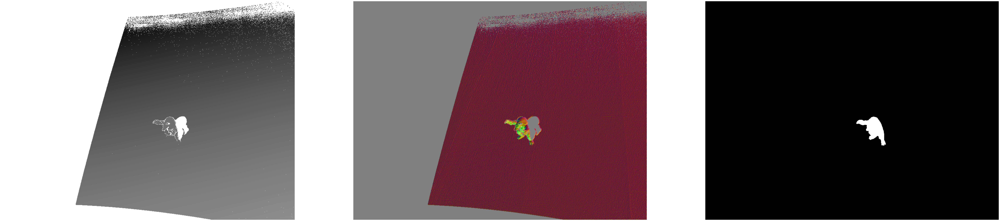

In [ ]:
mask = load_mask(DATASET + '/real/scan_000_labels.png')
print(np.amax(mask))
print(mask.shape)
show(positions[:, :, 2], normals, mask)

# Dataset Parser

In [7]:
def axial_noise_polynomial(z, o):
  return 0.599 - 1.43 * 10**(-3) * z - 8.94 * 10**(-3) * o + 8.84 * 10**(-7) * z**(2) + 1.27 * 10**(-5) * z * o + 2.75 * 10**(-5) * o**(2)

def lateral_noise_polynomial(z, o):
  return 0.915 - 6.91 * 10**(-5) * z + 2.84 * 10 ** (-3) * o

def generate_axial_noise(depth, angles):
  noise = np.zeros((depth.shape[0], depth.shape[1]))
  for y in range(noise.shape[0]):
    for x in range(noise.shape[1]):
      sigma = axial_noise_polynomial(depth[y][x], angles[y][x])
      noise[y][x] = np.random.normal(loc=0, scale=sigma)
  return np.array(noise)

def generate_lateral_noise(depth, angles):
  noise = np.zeros((depth.shape[0], depth.shape[1], 2))
  for y in range(noise.shape[0]):
    for x in range(noise.shape[1]):
      sigma = lateral_noise_polynomial(depth[y][x], angles[y][x])
      noise[y][x][0] = np.random.normal(loc=0, scale=sigma)
      noise[y][x][1] = np.random.normal(loc=0, scale=sigma)
  return np.array(noise)

In [8]:
def add_axial_noise(depth, angles):
  return depth + generate_axial_noise(depth, angles) * NOISE_MULT

def add_lateral_noise(map, depth, angles):
  noisy = map.copy()
  noise = generate_lateral_noise(depth, angles) * NOISE_MULT

  for y in range(noisy.shape[0]):
    for x in range(noisy.shape[1]):
      dy, dx = noise[y][x]
      newY = int(np.round(y + dy))
      newX = int(np.round(x + dx))
      if 0 <= newY < noisy.shape[0] and 0 <= newX < noisy.shape[1]:
        noisy[newY, newX] = map[y, x]

  return np.array(noisy)

In [9]:
class Generator(tf.keras.utils.Sequence):
    def __init__(self, datasets_path, gt=True, noise=True):
      self.masks, self.positions, self.inputs, self.xyzs = [], [], [], []
      self.gt = gt
      self.noise = noise
      self.load_data(datasets_path)

    def load_data(self, dataset_path):
      files = os.listdir(dataset_path)
      files.sort()
      #random.shuffle(files)
      for f in files:
        if "_positions" in f:
          print(dataset_path + f[:-13])
          p_path = dataset_path + f
          n_path = dataset_path + f[:-13] + 'normals.exr'
          positions, normals, xyz = load_scan(p_path, n_path, not self.gt)

          depth = positions[:, :, 2]
          normals = normals
          angles = np.zeros(depth.shape)

          if NOISE_MULT > 0 and self.noise:
            depth = add_axial_noise(depth, angles)

          normalized = depth / MOTION_CAM_MAX_RANGE
          normalized = np.expand_dims(normalized, axis=2)
          stacked = np.concatenate([normals, normalized], axis=2)

          if NOISE_MULT > 0 and self.noise:
            stacked = add_lateral_noise(stacked, depth, angles)

          self.inputs.append(np.expand_dims(stacked, axis=0))
          if self.gt:
            mask = load_mask(dataset_path + f[:-13] + 'labels.png')
            self.masks.append(np.expand_dims(mask, axis=0))
          else:
            self.positions.append(positions)
            self.xyzs.append(xyz)

    def get_positions_and_xyzs(self, index):
      return self.positions[index], self.xyzs[index]

    def __len__(self):
      return len(self.masks)

    def __getitem__(self, index):
      return self.inputs[index], self.masks[index] if self.gt else None

In [ ]:
train_generator = Generator(DATASET + 'train/')
val_generator = Generator(DATASET + 'val/')
test_generator = Generator(DATASET + 'test/')
real_generator = Generator(DATASET + 'real/', gt=False, noise=False)
real_gt = Generator(DATASET + 'real/', gt=True, noise=False)

gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/noise/scan_016_


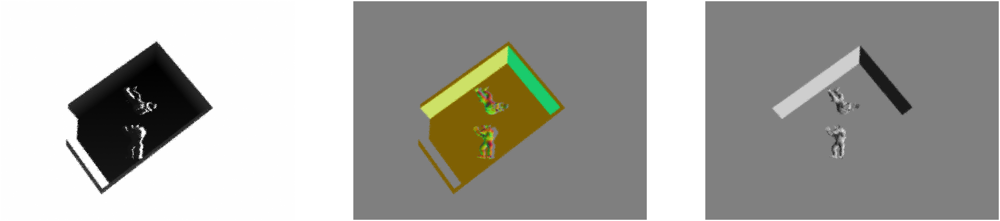

(1, 772, 1032, 4)
(1, 772, 1032, 1)


In [ ]:
noise_generator = Generator(DATASET + 'noise/', gt=True, noise=True)

test_input, test_mask = noise_generator[0]
show(test_input[0, :, :, 3], test_input[0, :, :, :3], test_input[0, :, :, :3])

print(test_input.shape)
print(test_mask.shape)

# Neural Network


In [ ]:
def net(i):
    c1 = tf.keras.layers.Conv2D(16, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (i)
    c1 = tf.keras.layers.Conv2D(16, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (c1)
    p1 = tf.keras.layers.MaxPooling2D(2) (c1)

    c2 = tf.keras.layers.Conv2D(32, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (p1)
    c2 = tf.keras.layers.Conv2D(32, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (c2)
    p2 = tf.keras.layers.MaxPooling2D(2) (c2)

    c3 = tf.keras.layers.Conv2D(64, 5, activation=tf.keras.layers.LeakyReLU(), padding='same') (p2)
    c3 = tf.keras.layers.Conv2D(64, 5, activation=tf.keras.layers.LeakyReLU(), padding='same') (c3)

    u4 = tf.keras.layers.Conv2DTranspose(32, 2, strides=(2, 2), padding='same') (c3)
    u4 = tf.keras.layers.concatenate([u4, c2])
    c4 = tf.keras.layers.Conv2D(32, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (u4)
    c4 = tf.keras.layers.Conv2D(32, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (c4)

    u5 = tf.keras.layers.Conv2DTranspose(16, 2, strides=(2, 2), padding='same') (c4)
    u5 = tf.keras.layers.concatenate([u5, c1])
    c5 = tf.keras.layers.Conv2D(16, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (u5)
    c5 = tf.keras.layers.Conv2D(16, 3, activation=tf.keras.layers.LeakyReLU(), padding='same') (c5)
    o = tf.keras.layers.Conv2D(1, 1, activation='sigmoid') (c5)
    return o


def generate():
    i = tf.keras.Input(shape=(None, None, 4))
    o = net(i)
    model = tf.keras.Model(inputs=i, outputs=o)

    print(model.summary())
    print('Total number of layers: {}'.format(len(model.layers)))

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4),
                  loss='binary_crossentropy',
                  metrics=metrics)

    return model

model = generate()
tf.keras.utils.plot_model(model, to_file='model.png')

In [ ]:
filepath = 'model.keras'
checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=filepath,
                             monitor='val_binary_io_u',
                             verbose=1,
                             save_best_only=True,
                             mode='max')


start = time.time()
history = model.fit(train_generator,
                    steps_per_epoch=len(train_generator),
                    epochs=48,
                    validation_data=real_gt,
                    validation_steps=len(real_gt),
                    callbacks=[checkpoint])
print(f"Elapsed time: {time.time() - start} seconds")

In [ ]:
real_input, _ = real_generator[5]
print(real_input.shape)
prediction = model.predict(real_input)
prediction = (prediction[0] > 0.7).astype(np.uint8)

print(prediction.shape)

kernel = np.ones((5,5),np.uint8)
prediction = cv2.erode(prediction, kernel, iterations = 1)
prediction = cv2.dilate(prediction, kernel, iterations = 4)
prediction = np.expand_dims(prediction, axis=2)

show(real_input[0, :, :, 3], real_input[0, :, :, :3], prediction)

In [10]:
real_val = Generator(DATASET + 'real/', gt=True, noise=False)
real_test = Generator(DATASET + 'cvww/', gt=True, noise=False)

gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_000_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_001_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_002_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_003_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_004_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_005_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_006_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_007_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_008_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_009_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_010_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_011_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/armadillo/real/scan_012_
gdrive/My Drive/Colab Notebooks//Skeletex3DData/arm

1/1 [==============================] - 0s 193ms/step


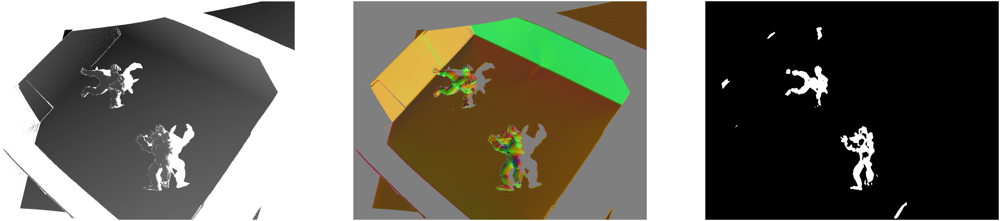

1/1 [==============================] - 0s 56ms/step


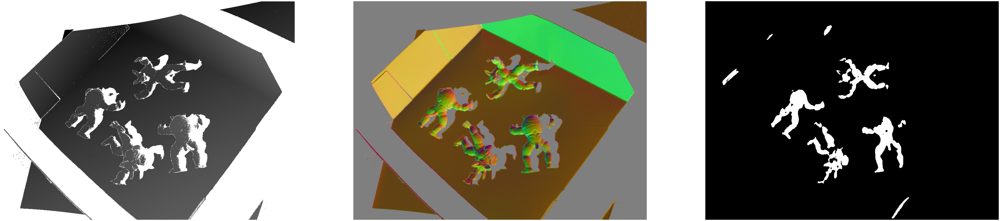

1/1 [==============================] - 0s 54ms/step


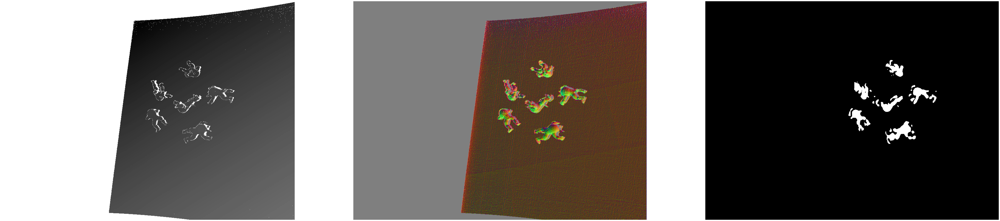

In [42]:
model = tf.keras.models.load_model(MODELS + "model_1_25.keras")

for i in [13, 16, 23]:
  test_input, _ = real_test[i]
  prediction = model.predict(test_input)
  prediction = prediction[0]
  show(test_input[0, :, :, 3], test_input[0, :, :, :3], prediction > 0.7)

In [40]:
iou = []
for model_name in ["0_00", "0_25", "0_50", "0_75", "1_00", "1_25", "1_50", "1_75", "2_00", "2_25", "2_50", "2_75", "3_00", "3_25", "3_50", "3_75", "4_00"]:
  model = tf.keras.models.load_model(MODELS + "model_" + model_name + ".keras")
  result = model.evaluate(real_test)
  iou.append(result[4])
  print(model_name)

26/26 [==============================] - 3s 49ms/step - loss: 0.2535 - accuracy: 0.8981 - precision: 0.2017 - recall: 0.6231 - binary_io_u: 0.5378
0_00
26/26 [==============================] - 2s 39ms/step - loss: 0.1652 - accuracy: 0.9089 - precision: 0.2166 - recall: 0.5892 - binary_io_u: 0.5476
0_25
26/26 [==============================] - 2s 44ms/step - loss: 0.1824 - accuracy: 0.9278 - precision: 0.3122 - recall: 0.8445 - binary_io_u: 0.6104
0_50
26/26 [==============================] - 2s 42ms/step - loss: 0.2142 - accuracy: 0.9229 - precision: 0.2981 - recall: 0.8491 - binary_io_u: 0.6018
0_75
26/26 [==============================] - 2s 37ms/step - loss: 0.1290 - accuracy: 0.9448 - precision_1: 0.3610 - recall_1: 0.7007 - binary_io_u: 0.6281
1_00
26/26 [==============================] - 2s 37ms/step - loss: 0.0791 - accuracy: 0.9723 - precision: 0.6124 - recall: 0.6225 - binary_io_u: 0.7091
1_25
26/26 [==============================] - 2s 37ms/step - loss: 0.1261 - accuracy: 0.9

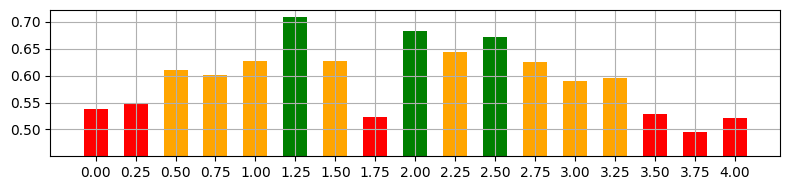

In [41]:
noises = [0, 0.25, 0.5, 0.75, 1.0, 1.25, 1.5, 1.75, 2, 2.25, 2.5, 2.75, 3.0, 3.25, 3.5, 3.75, 4]

color = [{p<0.55: 'red', 0.55<=p<=0.65: 'orange', p>0.65: 'green'}[True] for p in iou]

fig, ax = plt.subplots()
fig.set_figheight(2)
fig.set_figwidth(8)
ax.xaxis.set_ticks(np.arange(0, 4.1, 0.25))
ax.yaxis.set_ticks(np.arange(0.5, 1.0, 0.05))
ax.bar(noises, [(i - 0.45) for i in iou], color =color, width = 0.15, bottom=0.45)
#ax.set(xlabel='Noise Multiplicator', ylabel='IoU on Real Samples',
#       title='Evaluation of Adding Axial and Lateral Noise to Synthetic Data')
ax.grid(which="major")
plt.tight_layout()
#ax.tight_layout()
fig.savefig("noise.pdf")
plt.show()